In [1]:
from mpi4py import MPI
import gmsh
import numpy as np
from scipy.spatial import cKDTree
import pyvista as pv
from dolfinx import plot

# 1) Load MRST data (Pa) with header x,y,pressure
data = np.loadtxt("pressure_field_lagrange_example1.csv", delimiter=",", skiprows=1)
x_mrst, y_mrst, p_mrst = data[:, 0], data[:, 1], data[:, 2]

# --- before the refinement loop (rank 0 only collects) ---
h_list, L2_list, L2_fem_list, rL2_list, rL2s_fem_list, H1s_list, rH1s_list = [], [], [], [], [], [], []

plotter = pv.Plotter(shape=(2, 4), window_size=(2000, 1000))
N_ref = 10

Lx, Ly = 1.0, 1.0
y_start, y_end = 0.0, 1.0
x_start, x_end = 0.25, 0.75


In [ ]:

for ref in range(N_ref+1):
    # Initialize gmsh
    gmsh.initialize()
    gmsh.option.setNumber("General.Terminal", 0)
    gmsh.model.add("rect_with_partial_interface")

    if MPI.COMM_WORLD.rank == 0:
        # --------------------------
        # Parameters
        # --------------------------

        lc = 1.0/ (2**ref)          # mesh size
        h = lc

        gmsh.option.setNumber("Mesh.MeshSizeMin", h)
        gmsh.option.setNumber("Mesh.MeshSizeMax", h)
        gmsh.option.setNumber("Mesh.SaveAll", 1)   # <-- add this before meshing
        # lc = 0.3
        order = 1          # element order

        # --------------------------
        # 1. Define rectangular domain Ω
        # --------------------------
        p1 = gmsh.model.occ.addPoint(0, 0, 0)
        p2 = gmsh.model.occ.addPoint(Lx, 0, 0)
        p3 = gmsh.model.occ.addPoint(Lx, Ly, 0)
        p4 = gmsh.model.occ.addPoint(0, Ly, 0)
        l1 = gmsh.model.occ.addLine(p1, p2)
        l2 = gmsh.model.occ.addLine(p2, p3)
        l3 = gmsh.model.occ.addLine(p3, p4)
        l4 = gmsh.model.occ.addLine(p4, p1)
        loop = gmsh.model.occ.addCurveLoop([l1, l2, l3, l4])
        surf = gmsh.model.occ.addPlaneSurface([loop])

        # --------------------------
        # 2. Add an internal partial horizontal line Γ
        # --------------------------
        p5 = gmsh.model.occ.addPoint(x_start, y_start, 0)
        p6 = gmsh.model.occ.addPoint(x_end, y_end, 0)
        l5 = gmsh.model.occ.addLine(p5, p6)

        # --------------------------
        # 3. Fragment the surface with the internal line (split mesh)
        # --------------------------
        gmsh.model.occ.fragment([(2, surf)], [(1, l5)])
        gmsh.model.occ.synchronize()

        # --------------------------
        # 4. Define physical groups
        # --------------------------
        # Surface (bulk Ω)
        # gmsh.model.addPhysicalGroup(2, [surf], 1)
        # gmsh.model.setPhysicalName(2, 1, "Omega")
        omega = [t for (d, t) in gmsh.model.getEntities(2)]
        gmsh.model.addPhysicalGroup(2, omega, 1)
        gmsh.model.setPhysicalName(2, 1, "Omega")

        # Identify the internal line (Γ)
        # 2) Recompute ALL post-fragment edges from surface boundaries
        from collections import Counter

        all_edges = []
        for s in omega:
            # boundary curves of each surface
            b = gmsh.model.getBoundary([(2, s)], oriented=False, recursive=False)
            all_edges.extend([t for (d, t) in b])

        counts = Counter(all_edges)

        # Outer boundary edges (belong to exactly one surface)
        boundary_curves = [t for t, c in counts.items() if c == 1]

        if boundary_curves:
            pgB = gmsh.model.addPhysicalGroup(1, boundary_curves, 3)   # id=3 for Boundary
            gmsh.model.setPhysicalName(1, pgB, "Boundary")

        # 3) Gamma = all 1D curves that are NOT in Boundary
        all_1d = [t for (d, t) in gmsh.model.getEntities(1)]
        boundary_1d = set(gmsh.model.getEntitiesForPhysicalGroup(1, 3))  # id=3
        gamma_curves = [t for t in all_1d if t not in boundary_1d]

        if gamma_curves:
            gmsh.model.addPhysicalGroup(1, gamma_curves, 2)   # id=2 for Gamma
            gmsh.model.setPhysicalName(1, 2, "Gamma")

        # --------------------------
        # 5. Generate and save mesh
        # --------------------------
        # print("Physical groups (dim, tag):", gmsh.model.getPhysicalGroups())
        # print("Gamma curves:", gmsh.model.getEntitiesForPhysicalGroup(1, 2))

        gmsh.model.mesh.generate(2)
        gmsh.model.mesh.setOrder(order)
        filename = f"diagonal_fracture_ex1_{ref}.msh"
        gmsh.write(filename)
    gmsh.finalize()

In [2]:
from dolfinx import mesh, fem
import ufl
import numpy as np

# ---------------------------------------------------------------------
# 1. Mesh and interface tags (similar to Γ tagging in the workshop)
# ---------------------------------------------------------------------
# Load Gmsh mesh (2D bulk Ω + 1D interface Γ)
from dolfinx.io import gmsh as gmshio
ref = N_ref-1
filename = f"diagonal_fracture_ex1_{ref}.msh"
msh, cell_markers, facet_markers = gmshio.read_from_msh(filename, MPI.COMM_WORLD, 0, gdim=2)[0:3]

tdim = msh.topology.dim  # 2
fdim = tdim - 1             # 1

lc = 1.0/ (2**ref)          # mesh size
h = lc

# Find all facets tagged as Gamma (tag=2)
omega = msh
gamma_entities = facet_markers.find(2)

# Create a submesh for Γ (same as gamma in the JSDokken example)
gamma, gamma_to_omega = mesh.create_submesh(omega, fdim, gamma_entities)[0:2]

# Define interface tag ID (as defined in Gmsh)
Gamma_tag = 2  # <-- replace with your actual tag ID for the interface Γ

# ---------------------------------------------------------------------
# 2. Function spaces
# ---------------------------------------------------------------------
order = 1
V_m = fem.functionspace(omega, ("Lagrange", order))  # bulk Ω
V_f = fem.functionspace(gamma, ("Lagrange", order))   # interface Γ
V_l = fem.functionspace(gamma, ("Lagrange", order))   # multiplier space on Γ
W = ufl.MixedFunctionSpace(V_m, V_f, V_l)

# ---------------------------------------------------------------------
# 3. Trial and Test functions
# ---------------------------------------------------------------------
phi, psi, mu = ufl.TestFunctions(W)
dp_m, dp_f, dl = ufl.TrialFunctions(W)
p_m = fem.Function(V_m, name="p_m")
p_f = fem.Function(V_f, name="p_f")
lmbd = fem.Function(V_f, name="lmbd")

# ---------------------------------------------------------------------
# 4. Spatial coordinates and given data
# ---------------------------------------------------------------------
x = ufl.SpatialCoordinate(msh)
f_m = fem.Constant(msh, 0.0)
f_f = fem.Constant(msh, 0.0)

k_m = fem.Constant(omega, 1.0)
k_f = fem.Constant(gamma, 10.0)

dx = ufl.Measure("dx", domain=omega)
ds = ufl.Measure("ds", domain=omega, subdomain_data=facet_markers, subdomain_id=Gamma_tag)
dx_f = ufl.Measure("dx", domain=gamma)

# ---------------------------------------------------------------------
# 5. Weak formulations
# ---------------------------------------------------------------------

# --- Bulk domain Ω ---------------------------------------------------
a_m0 = ufl.inner(k_m * ufl.grad(p_m), ufl.grad(phi)) * dx
a_m1 = -lmbd * phi * ds
a_m = a_m0 + a_m1
L_m = f_m * phi * dx

# --- Interface Γ -----------------------------------------------------
a_f0 = ufl.inner(k_f * ufl.grad(p_f), ufl.grad(psi)) * ds
a_f1 = lmbd * psi * ds
a_f = a_f0 + a_f1
L_f = f_f * psi * ds

# --- Lagrange multiplier (constraint tr(p_m) = p_f) ------------------
a_l0 = p_m * mu * ds
a_l1 = -p_f * mu * ds
a_l = a_l0 + a_l1
L_l = fem.Constant(msh, 0.0) * mu * ds

# ---------------------------------------------------------------------
# 6. Combine interface weak form
# ---------------------------------------------------------------------
a_gamma = a_f + a_l
L_gamma = L_f + L_l

F = a_m - L_m + a_gamma - L_gamma
residual = ufl.extract_blocks(F)

jac = ufl.derivative(F, p_m, dp_m) + ufl.derivative(F, p_f, dp_f) + ufl.derivative(F, lmbd, dl)
J = ufl.extract_blocks(jac)

# Compute bounding box to locate sides
coords = omega.geometry.x
x = coords[:, 0]
y = coords[:, 1]

xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()

# Tolerance for side detection
tol = 1e-10 * max(xmax - xmin, ymax - ymin)

# Locate dofs on each side
left_dofs   = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmin, atol=tol))
right_dofs  = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmax, atol=tol))
bottom_dofs = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymin, atol=tol))
top_dofs    = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymax, atol=tol))

# Union of all boundary dofs for which we enforce a value
# all_dofs = np.unique(np.concatenate([left_dofs, right_dofs, bottom_dofs, top_dofs]))
all_dofs = np.unique(np.concatenate([left_dofs, right_dofs]))

# Build a Function-valued BC so we can assign side-dependent values
p_m_bc = fem.Function(V_m)
# p_m_bc.x.array[:] = 1.0  # default 0 (bottom + right)
p_m_bc.x.array[left_dofs] = 1.0
p_m_bc.x.array[right_dofs]  = 4.0

# One BC object over the union of dofs with piecewise values
bc_pm = fem.dirichletbc(p_m_bc, all_dofs)

bcs = [bc_pm]

print("DOFs in p_m:", p_m.function_space.dofmap.index_map.size_global)
print("DOFs in p_f:", p_f.function_space.dofmap.index_map.size_global)
print("DOFs in λ:", lmbd.function_space.dofmap.index_map.size_global)
total_dofs = (
    p_m.function_space.dofmap.index_map.size_global
    + p_f.function_space.dofmap.index_map.size_global
    + lmbd.function_space.dofmap.index_map.size_global
)
print("Total DOFs:", total_dofs)

from dolfinx.fem import petsc
entity_maps = [gamma_to_omega]

nlp = petsc.NonlinearProblem(
    residual,
    u=[p_m, p_f, lmbd],
    J=J,
    bcs=bcs,
    entity_maps=entity_maps,
    petsc_options={
        "snes_monitor": None,
        "snes_max_it": 200,  # default is 50, set your own limit
        "ksp_type": "preonly",
        "pc_type": "lu",
        "pc_factor_mat_solver_type": "mumps",
        "mat_mumps_icntl_14": 120,
        "ksp_error_if_not_converged": True,
        "snes_error_if_not_converged": True,
    },
    petsc_options_prefix="pmix_",
)
max_iterations = 25
normed_diff = 0
tol = 1e-5

nlp.solve()
iterations = nlp.solver.getIterationNumber()
print(f"Converged in {iterations} Newton iterations")

p_m_exact = p_m
p_f_exact = p_f
lmbd_exact = lmbd

Info    : Reading 'diagonal_fracture_ex1_9.msh'...
Info    : 15 entities
Info    : 304598 nodes
Info    : 609773 elements                                                                                     
Info    : Done reading 'diagonal_fracture_ex1_9.msh'                                                             
DOFs in p_m: 304598
DOFs in p_f: 574
DOFs in λ: 574
Total DOFs: 305746
  0 SNES Function norm 1.460361336455e+02
  1 SNES Function norm 1.717328202115e-10
Converged in 1 Newton iterations


Info    : Reading 'diagonal_fracture_ex1_0.msh'...
Info    : 15 entities
Info    : 7 nodes
Info    : 20 elements
Info    : Done reading 'diagonal_fracture_ex1_0.msh'
DOFs in p_m: 7
DOFs in p_f: 3
DOFs in λ: 3
Total DOFs: 13
  0 SNES Function norm 1.008574351360e+01
  1 SNES Function norm 6.062444682523e-15
Converged in 1 Newton iterations


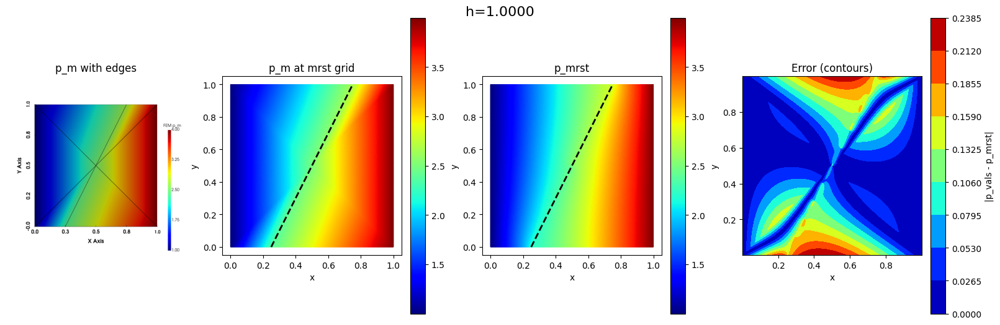

Info    : Reading 'diagonal_fracture_ex1_1.msh'...
Info    : 15 entities
Info    : 16 nodes
Info    : 39 elements
Info    : Done reading 'diagonal_fracture_ex1_1.msh'
DOFs in p_m: 16
DOFs in p_f: 4
DOFs in λ: 4
Total DOFs: 24
  0 SNES Function norm 1.273540243182e+01
  1 SNES Function norm 1.697435331116e-13
Converged in 1 Newton iterations


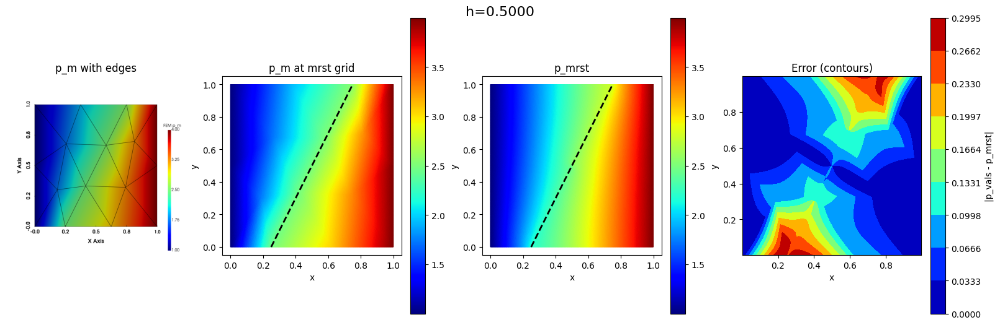

Info    : Reading 'diagonal_fracture_ex1_2.msh'...
Info    : 15 entities
Info    : 32 nodes
Info    : 73 elements
Info    : Done reading 'diagonal_fracture_ex1_2.msh'
DOFs in p_m: 32
DOFs in p_f: 6
DOFs in λ: 6
Total DOFs: 44
  0 SNES Function norm 1.390002872460e+01
  1 SNES Function norm 2.340224355471e-13
Converged in 1 Newton iterations


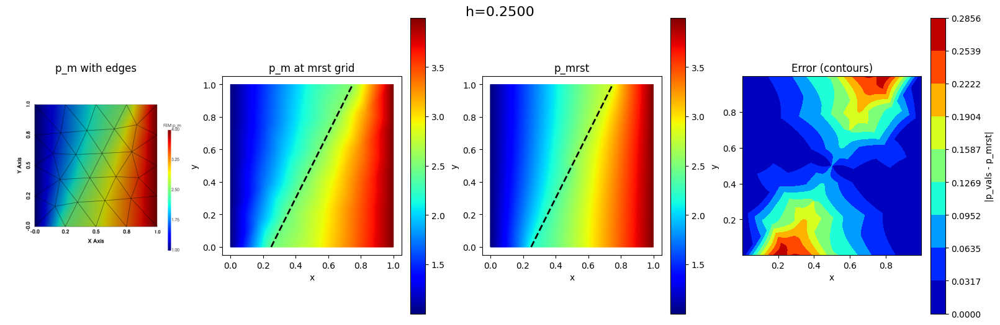

Info    : Reading 'diagonal_fracture_ex1_3.msh'...
Info    : 15 entities
Info    : 94 nodes
Info    : 201 elements
Info    : Done reading 'diagonal_fracture_ex1_3.msh'
DOFs in p_m: 94
DOFs in p_f: 10
DOFs in λ: 10
Total DOFs: 114
  0 SNES Function norm 1.875006512098e+01
  1 SNES Function norm 2.681920915849e-13
Converged in 1 Newton iterations


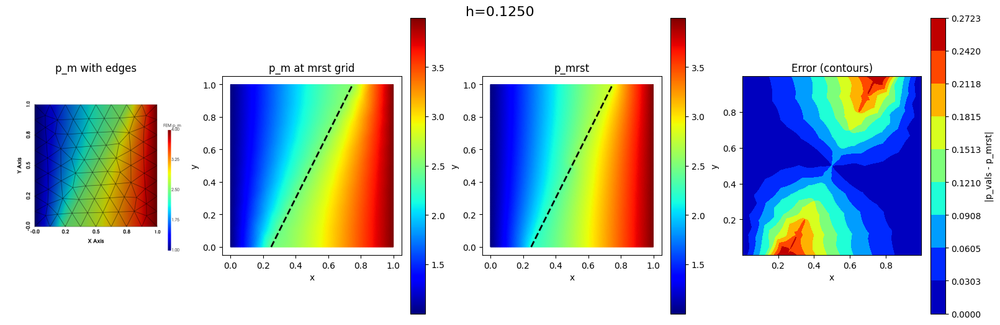

Info    : Reading 'diagonal_fracture_ex1_4.msh'...
Info    : 15 entities
Info    : 349 nodes
Info    : 720 elements
Info    : Done reading 'diagonal_fracture_ex1_4.msh'
DOFs in p_m: 349
DOFs in p_f: 19
DOFs in λ: 19
Total DOFs: 387
  0 SNES Function norm 2.583846717804e+01
  1 SNES Function norm 1.104357896659e-12
Converged in 1 Newton iterations


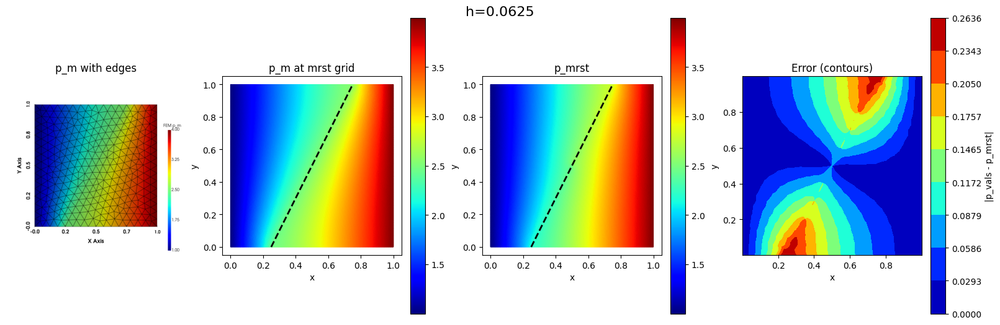

Info    : Reading 'diagonal_fracture_ex1_5.msh'...
Info    : 15 entities
Info    : 1286 nodes
Info    : 2612 elements
Info    : Done reading 'diagonal_fracture_ex1_5.msh'
DOFs in p_m: 1286
DOFs in p_f: 37
DOFs in λ: 37
Total DOFs: 1360
  0 SNES Function norm 3.608050513994e+01
  1 SNES Function norm 2.381353708405e-12
Converged in 1 Newton iterations


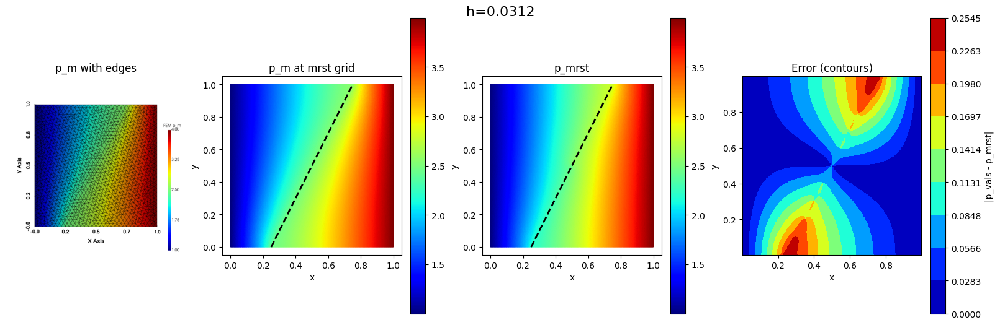

Info    : Reading 'diagonal_fracture_ex1_6.msh'...
Info    : 15 entities
Info    : 4949 nodes
Info    : 9974 elements
Info    : Done reading 'diagonal_fracture_ex1_6.msh'
DOFs in p_m: 4949
DOFs in p_f: 73
DOFs in λ: 73
Total DOFs: 5095
  0 SNES Function norm 5.249261618378e+01
  1 SNES Function norm 1.021145693661e-11
Converged in 1 Newton iterations


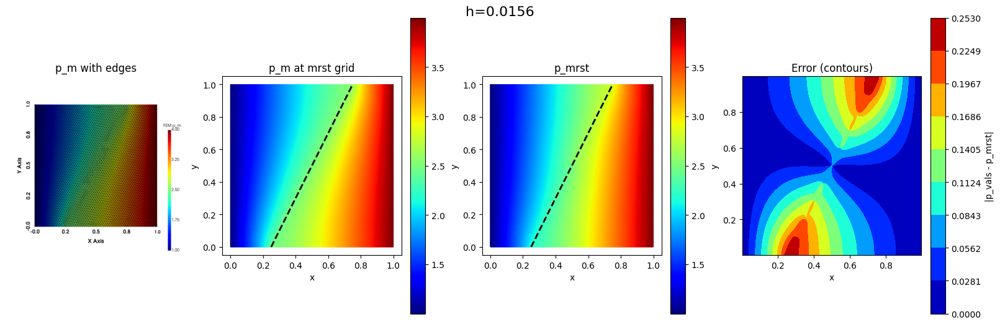

Info    : Reading 'diagonal_fracture_ex1_7.msh'...
Info    : 15 entities
Info    : 19447 nodes
Info    : 39042 elements
Info    : Done reading 'diagonal_fracture_ex1_7.msh'
DOFs in p_m: 19447
DOFs in p_f: 145
DOFs in λ: 145
Total DOFs: 19737
  0 SNES Function norm 7.294984747503e+01
  1 SNES Function norm 2.303865052252e-11
Converged in 1 Newton iterations


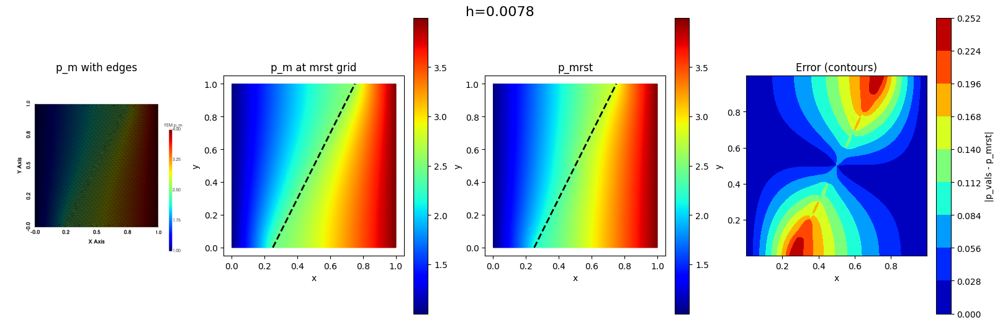

Info    : Reading 'diagonal_fracture_ex1_8.msh'...
Info    : 15 entities
Info    : 76742 nodes
Info    : 153775 elements
Info    : Done reading 'diagonal_fracture_ex1_8.msh'                                                             
DOFs in p_m: 76742
DOFs in p_f: 288
DOFs in λ: 288
Total DOFs: 77318
  0 SNES Function norm 1.029118255522e+02
  1 SNES Function norm 8.033487070897e-11
Converged in 1 Newton iterations


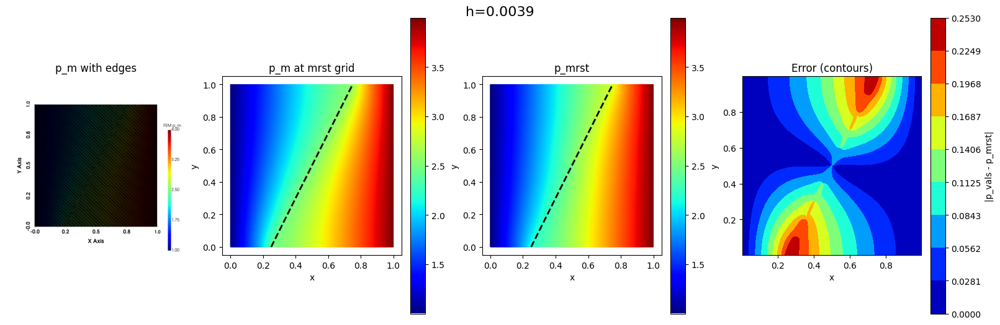

/home/muchamad/PhD/fenicsx/lib/python3.13/site-packages/pyvista/jupyter/notebook.py:56: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


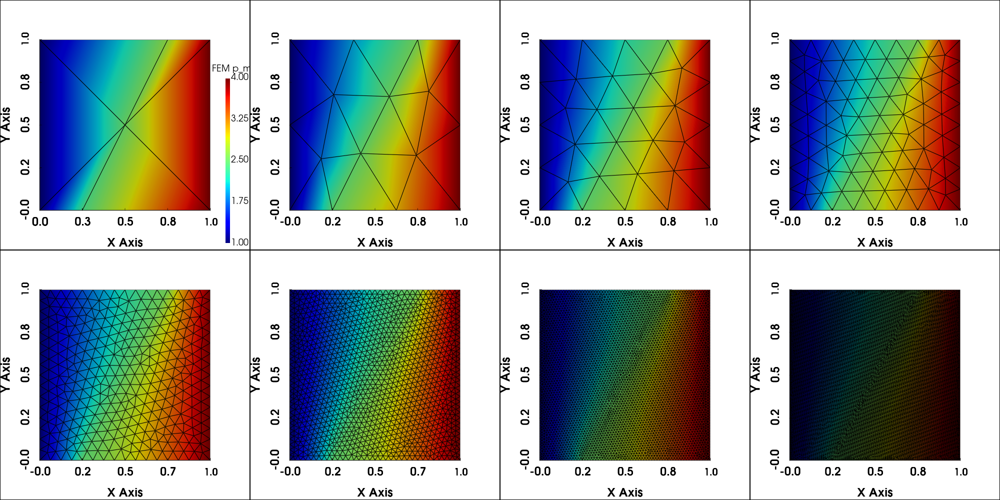

In [3]:
from dolfinx import geometry
def l2_h1_errors(p, p_exact, comm=MPI.COMM_WORLD):
    mesh_fine = p_exact.function_space.mesh
    mesh_coarse = p.function_space.mesh

    # Build a search tree on the fine mesh
    bbt_fine = geometry.bb_tree(mesh_fine, mesh_fine.topology.dim)

    mid_tree_fine = geometry.create_midpoint_tree(
        mesh_fine, tdim,
        np.arange(mesh_fine.topology.index_map(tdim).size_local, dtype=np.int32)
    )

    # Allocate target on the coarse space
    # Build search trees on the COARSE mesh (we evaluate p there)
    # Search structures on the COARSE mesh (where p lives)
    bbt_coarse = geometry.bb_tree(mesh_coarse, tdim)
    mid_tree_coarse = geometry.create_midpoint_tree(
        mesh_coarse, tdim,
        np.arange(mesh_coarse.topology.index_map(tdim).size_local, dtype=np.int32)
    )

    # Allocate target on the FINE space (values of p sampled at fine DoF points)
    p_coarse_on_exact = fem.Function(p_exact.function_space)

    def eval_p_on_points(x: np.ndarray) -> np.ndarray:
        """Return p (defined on COARSE mesh) evaluated at points x on the FINE mesh."""
        gdim, N = x.shape
        if gdim == 2:
            X3 = np.column_stack([x.T, np.zeros(N, dtype=np.float64)])  # (N, 3)
        elif gdim == 3:
            X3 = x.T.copy()                                             # (N, 3)
        else:
            raise ValueError(f"Unsupported geometric dimension gdim={gdim}")

        # 1) candidates on COARSE mesh
        cands = geometry.compute_collisions_points(bbt_coarse, X3)
        # 2) filter to true hits
        hits = geometry.compute_colliding_cells(mesh_coarse, cands, X3)

        # 3) pick one owning cell per point
        cells = np.full(N, -1, dtype=np.int32)
        for i in range(N):
            li = hits.links(i)
            if len(li) > 0:
                cells[i] = li[0]

        # Fallback: nearest coarse cell by midpoint
        missing = np.where(cells == -1)[0]
        if missing.size > 0:
            nearest = geometry.compute_closest_entity(
                bbt_coarse, mid_tree_coarse, mesh_coarse, X3[missing]
            )
            cells[missing] = nearest

        # 4) evaluate p at those points/cells
        vals_1d = p.eval(X3, cells)                     # (N,)
        return np.asarray(vals_1d, dtype=np.float64).reshape(1, N)  # scalar -> (1, N)
        # For vector-valued fields of size m: return np.asarray(vals_1d).T  # (m, N)

    # IMPORTANT: pass the callable itself
    p_coarse_on_exact.interpolate(eval_p_on_points)

    # Integrate on the fine mesh
    dx = ufl.dx(domain=mesh_fine)
    err = p_exact - p_coarse_on_exact

    # ||err||_L2^2
    L2_sq_local = fem.assemble_scalar(fem.form(ufl.inner(err, err) * dx))
    L2_sq = comm.allreduce(L2_sq_local, op=MPI.SUM)

    # |err|_H1^2 = ||∇err||_L2^2
    H1_semi_sq_local = fem.assemble_scalar(fem.form(ufl.inner(ufl.grad(err), ufl.grad(err)) * dx))
    H1_semi_sq = comm.allreduce(H1_semi_sq_local, op=MPI.SUM)

    # Norms
    err_L2 = np.sqrt(L2_sq)
    err_H1_full = np.sqrt(L2_sq + H1_semi_sq)

    # --- relative errors ---
    # ||p_exact||_L2^2
    L2_exact_sq_local = fem.assemble_scalar(fem.form(ufl.inner(p_exact, p_exact) * dx))
    L2_exact_sq = comm.allreduce(L2_exact_sq_local, op=MPI.SUM)

    # |p_exact|_H1^2
    H1_semi_exact_sq_local = fem.assemble_scalar(
        fem.form(ufl.inner(ufl.grad(p_exact), ufl.grad(p_exact)) * dx)
    )
    H1_semi_exact_sq = comm.allreduce(H1_semi_exact_sq_local, op=MPI.SUM)

    # Norms of exact
    exact_L2 = np.sqrt(L2_exact_sq)
    exact_H1_full = np.sqrt(L2_exact_sq + H1_semi_exact_sq)

    # Relative errors with zero-denominator guard
    rel_L2 = err_L2 / exact_L2 if exact_L2 > 0 else (0.0 if err_L2 == 0 else np.inf)
    rel_H1_full = err_H1_full / exact_H1_full if exact_H1_full > 0 else (0.0 if err_H1_full == 0 else np.inf)

    return err_L2, err_H1_full, rel_L2, rel_H1_full
    # return err_L2, err_H1_full

for ref in range(N_ref-1):
    from dolfinx import mesh, fem
    import ufl
    import numpy as np

    # ---------------------------------------------------------------------
    # 1. Mesh and interface tags (similar to Γ tagging in the workshop)
    # ---------------------------------------------------------------------
    # Load Gmsh mesh (2D bulk Ω + 1D interface Γ)
    from dolfinx.io import gmsh as gmshio
    filename = f"diagonal_fracture_ex1_{ref}.msh"
    msh, cell_markers, facet_markers = gmshio.read_from_msh(filename, MPI.COMM_WORLD, 0, gdim=2)[0:3]

    tdim = msh.topology.dim  # 2
    fdim = tdim - 1             # 1

    lc = 1.0/ (2**ref)          # mesh size
    h = lc

    # Find all facets tagged as Gamma (tag=2)
    omega = msh
    gamma_entities = facet_markers.find(2)

    # Create a submesh for Γ (same as gamma in the JSDokken example)
    gamma, gamma_to_omega = mesh.create_submesh(omega, fdim, gamma_entities)[0:2]

    # Define interface tag ID (as defined in Gmsh)
    Gamma_tag = 2  # <-- replace with your actual tag ID for the interface Γ

    # ---------------------------------------------------------------------
    # 2. Function spaces
    # ---------------------------------------------------------------------
    order = 1
    V_m = fem.functionspace(omega, ("Lagrange", order))  # bulk Ω
    V_f = fem.functionspace(gamma, ("Lagrange", order))   # interface Γ
    V_l = fem.functionspace(gamma, ("Lagrange", order))   # multiplier space on Γ
    W = ufl.MixedFunctionSpace(V_m, V_f, V_l)

    # ---------------------------------------------------------------------
    # 3. Trial and Test functions
    # ---------------------------------------------------------------------
    phi, psi, mu = ufl.TestFunctions(W)
    dp_m, dp_f, dl = ufl.TrialFunctions(W)
    p_m = fem.Function(V_m, name="p_m")
    p_f = fem.Function(V_f, name="p_f")
    lmbd = fem.Function(V_f, name="lmbd")

    # ---------------------------------------------------------------------
    # 4. Spatial coordinates and given data
    # ---------------------------------------------------------------------
    x = ufl.SpatialCoordinate(msh)
    f_m = fem.Constant(msh, 0.0)
    f_f = fem.Constant(msh, 0.0)

    k_m = fem.Constant(omega, 1.0)
    k_f = fem.Constant(gamma, 10.0)

    dx = ufl.Measure("dx", domain=omega)
    ds = ufl.Measure("ds", domain=omega, subdomain_data=facet_markers, subdomain_id=Gamma_tag)
    dx_f = ufl.Measure("dx", domain=gamma)

    # ---------------------------------------------------------------------
    # 5. Weak formulations
    # ---------------------------------------------------------------------

    # --- Bulk domain Ω ---------------------------------------------------
    a_m0 = ufl.inner(k_m * ufl.grad(p_m), ufl.grad(phi)) * dx
    a_m1 = -lmbd * phi * ds
    a_m = a_m0 + a_m1
    L_m = f_m * phi * dx

    # --- Interface Γ -----------------------------------------------------
    a_f0 = ufl.inner(k_f * ufl.grad(p_f), ufl.grad(psi)) * ds
    a_f1 = lmbd * psi * ds
    a_f = a_f0 + a_f1
    L_f = f_f * psi * ds

    # --- Lagrange multiplier (constraint tr(p_m) = p_f) ------------------
    a_l0 = p_m * mu * ds
    a_l1 = -p_f * mu * ds
    a_l = a_l0 + a_l1
    L_l = fem.Constant(msh, 0.0) * mu * ds

    # ---------------------------------------------------------------------
    # 6. Combine interface weak form
    # ---------------------------------------------------------------------
    a_gamma = a_f + a_l
    L_gamma = L_f + L_l

    F = a_m - L_m + a_gamma - L_gamma
    residual = ufl.extract_blocks(F)

    jac = ufl.derivative(F, p_m, dp_m) + ufl.derivative(F, p_f, dp_f) + ufl.derivative(F, lmbd, dl)
    J = ufl.extract_blocks(jac)

    # Compute bounding box to locate sides
    coords = omega.geometry.x
    x = coords[:, 0]
    y = coords[:, 1]

    xmin, xmax = x.min(), x.max()
    ymin, ymax = y.min(), y.max()

    # Tolerance for side detection
    tol = 1e-10 * max(xmax - xmin, ymax - ymin)

    # Locate dofs on each side
    left_dofs   = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmin, atol=tol))
    right_dofs  = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmax, atol=tol))
    bottom_dofs = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymin, atol=tol))
    top_dofs    = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymax, atol=tol))

    # Union of all boundary dofs for which we enforce a value
    # all_dofs = np.unique(np.concatenate([left_dofs, right_dofs, bottom_dofs, top_dofs]))
    all_dofs = np.unique(np.concatenate([left_dofs, right_dofs]))

    # Build a Function-valued BC so we can assign side-dependent values
    p_m_bc = fem.Function(V_m)
    # p_m_bc.x.array[:] = 1.0  # default 0 (bottom + right)
    p_m_bc.x.array[left_dofs] = 1.0
    p_m_bc.x.array[right_dofs]  = 4.0

    # One BC object over the union of dofs with piecewise values
    bc_pm = fem.dirichletbc(p_m_bc, all_dofs)

    bcs = [bc_pm]

    print("DOFs in p_m:", p_m.function_space.dofmap.index_map.size_global)
    print("DOFs in p_f:", p_f.function_space.dofmap.index_map.size_global)
    print("DOFs in λ:", lmbd.function_space.dofmap.index_map.size_global)
    total_dofs = (
        p_m.function_space.dofmap.index_map.size_global
        + p_f.function_space.dofmap.index_map.size_global
        + lmbd.function_space.dofmap.index_map.size_global
    )
    print("Total DOFs:", total_dofs)

    from dolfinx.fem import petsc
    entity_maps = [gamma_to_omega]

    nlp = petsc.NonlinearProblem(
        residual,
        u=[p_m, p_f, lmbd],
        J=J,
        bcs=bcs,
        entity_maps=entity_maps,
        petsc_options={
            "snes_monitor": None,
            "snes_max_it": 200,  # default is 50, set your own limit
            "ksp_type": "preonly",
            "pc_type": "lu",
            "pc_factor_mat_solver_type": "mumps",
            "mat_mumps_icntl_14": 120,
            "ksp_error_if_not_converged": True,
            "snes_error_if_not_converged": True,
        },
        petsc_options_prefix="pmix_",
    )
    max_iterations = 25
    normed_diff = 0
    tol = 1e-5

    nlp.solve()
    iterations = nlp.solver.getIterationNumber()
    print(f"Converged in {iterations} Newton iterations")

    err_L2_fem, err_H1_fem, rel_L2_fem, rel_H1_full_fem = l2_h1_errors(p_m, p_m_exact)

    # --- 1) Build 3D point array for DOLFINx eval (z=0)
    X_mrst = np.column_stack([x_mrst, y_mrst])
    N = X_mrst.shape[0]
    X3 = np.column_stack([X_mrst, np.zeros(N)])

    mesh0 = p_m.function_space.mesh
    tdim = mesh0.topology.dim

    # --- 2) Find the containing cell for each MRST point
    # 1) Bounding-box candidates
    bbt = geometry.bb_tree(mesh0, mesh0.topology.dim)
    cands = geometry.compute_collisions_points(bbt, X3)          # adjacency list

    # 2) True colliding cells (handles curved/high-order properly)
    hits = geometry.compute_colliding_cells(mesh0, cands, X3)     # adjacency list

    # 3) Pick one owning cell per point (use the first hit; empty -> -1)
    cells = np.full(X3.shape[0], -1, dtype=np.int32)
    offsets = hits.offsets

    for i in range(X3.shape[0]):
        li = hits.links(i)
        if len(li) > 0:
            cells[i] = li[0]

    # Optional: for any -1 (points on boundaries / tiny roundoff), snap to closest
    missing = np.where(cells == -1)[0]
    if missing.size:
        # Use midpoint tree for a robust fallback
        mid_tree = geometry.create_midpoint_tree(mesh0, mesh0.topology.dim,
                                                np.arange(mesh0.topology.index_map(mesh0.topology.dim).size_local, dtype=np.int32))
        # For each missing point, choose nearest cell by midpoint
        nearest = geometry.compute_closest_entity(bbt, mid_tree, mesh0, X3[missing])
        cells[missing] = nearest

    # 4) Evaluate p_m at MRST points
    p_vals = p_m.eval(X3, cells)  # shape (N,)

    diff2 = (p_vals.ravel() - p_mrst.ravel())**2

    # infer dx, dy from unique coordinates (assumes rectilinear, uniform spacing)
    ux = np.unique(x_mrst)
    uy = np.unique(y_mrst)
    dx = np.median(np.diff(ux)) if ux.size > 1 else 1.0
    dy = np.median(np.diff(uy)) if uy.size > 1 else 1.0

    L2_err = np.sqrt(np.sum(diff2) * dx * dy)

    # do the same for the reference to get a relative norm
    L2_ref = np.sqrt(np.sum(p_mrst**2) * dx * dy)
    rel_L2 = L2_err / (L2_ref + 1e-30)

    import matplotlib.pyplot as plt
    import matplotlib.tri as mtri

    # Inputs (1D arrays of same length N):
    # x, y = centroid coordinates (use your x_mrst, y_mrst)
    # p_vals, p_mrst = values at the same centroids
    x = np.asarray(x_mrst).ravel()
    y = np.asarray(y_mrst).ravel()
    p1 = np.asarray(p_vals).ravel()
    p2 = np.asarray(p_mrst).ravel()
    d2 = np.abs(p1 - p2)

    # Build triangulation
    tri = mtri.Triangulation(x, y)

    vmin = float(min(np.nanmin(p1), np.nanmin(p2)))
    vmax = float(max(np.nanmax(p1), np.nanmax(p2)))

    topo2, ctype2, geom2 = plot.vtk_mesh(p_m.function_space)
    grid_2d = pv.UnstructuredGrid(topo2, ctype2, geom2)
    grid_2d.point_data["p_m"] = p_m.x.array.real

    plotter0 = pv.Plotter(off_screen=True, window_size=(800, 800))
    plotter0.add_mesh(
        grid_2d, scalars="p_m", cmap="jet", show_edges=True, lighting=True,
            clim=[1, 4],
            scalar_bar_args={"title": "FEM p_m", "vertical": True, "width": 0.05, "height": 0.7}
    )
    plotter0.show_bounds()
    plotter0.view_xy()

    # Render to NumPy image (H,W,3 or 4)
    img = plotter0.screenshot(return_img=True)
    plotter0.close()

    fig, axes = plt.subplots(1, 4, figsize=(16, 5), constrained_layout=True)
    fig.suptitle(f"h={h:.4f}", fontsize=16, y=1.02)

    # Panel 0: PyVista rendering
    axes[0].imshow(img)
    axes[0].set_title("p_m with edges")
    axes[0].axis("off")  # image already has bounds

    # --- p_vals ---
    im0 = axes[1].tripcolor(tri, p1, shading='gouraud', vmin=vmin, vmax=vmax, cmap='jet')
    axes[1].plot(
        [x_start, x_end],  # X coordinates
        [y_start, y_end],  # Y coordinates
        color='black', linewidth=2, linestyle='--', label='Line segment'
    )
    axes[1].set_title('p_m at mrst grid')
    axes[1].set_aspect('equal')
    fig.colorbar(im0, ax=axes[1])

    # --- p_mrst ---
    im1 = axes[2].tripcolor(tri, p2, shading='gouraud', vmin=vmin, vmax=vmax, cmap='jet')
    axes[2].plot(
        [x_start, x_end],  # X coordinates
        [y_start, y_end],  # Y coordinates
        color='black', linewidth=2, linestyle='--', label='Line segment'
    )
    axes[2].set_title('p_mrst')
    axes[2].set_aspect('equal')
    fig.colorbar(im1, ax=axes[2])

    # --- diff² contours ---
    levels = np.linspace(d2.min(), np.percentile(d2, 100), 10)  # choose number of contour levels
    cont = axes[3].tricontourf(tri, d2, levels=levels, cmap='jet')
    # axes[2].clabel(cont, inline=True, fontsize=8, fmt="%.2e")  # label contours
    axes[3].set_title('Error (contours)')
    axes[3].set_aspect('equal')
    fig.colorbar(cont, ax=axes[3], label='|p_vals - p_mrst|')

    for ax in axes:
        ax.set_xlabel('x')
        ax.set_ylabel('y')

    plt.show()
    

    if MPI.COMM_WORLD.rank == 0:
        h_list.append(float(h))
        L2_list.append(float(L2_err))
        rL2_list.append(float(rel_L2))
        L2_fem_list.append(float(err_L2_fem))
        rL2s_fem_list.append(float(rel_L2_fem))
        H1s_list.append(float(err_H1_fem))
        rH1s_list.append(float(rel_H1_full_fem))

    if ref < 8:
        # Panel 1: MRST (cells)
        ip = int(ref/4)
        jp = ref % 4
        plotter.subplot(ip, jp)
        plotter.add_mesh(
            grid_2d, scalars="p_m", cmap="jet", show_edges=True, lighting=True,
            clim=[1, 4],
            scalar_bar_args={"title": "FEM p_m", "vertical": True, "width": 0.05, "height": 0.7}
        )
        plotter.show_bounds(); plotter.view_xy()
        plotter.link_views()
plotter.show()

In [9]:
from math import log
if MPI.COMM_WORLD.rank == 0 and len(h_list) > 0:
    # rates: p_i = log(e_{i-1}/e_i) / log(h_{i-1}/h_i)
    def _roc(errs, hs):
        out = [None]
        for i in range(1, len(errs)):
            e0, e1 = errs[i-1], errs[i]
            h0, h1 = hs[i-1], hs[i]
            if e0 > 0 and e1 > 0 and h0 != h1:
                out.append(log(e0/e1) / log(h0/h1))
            else:
                out.append(None)
        return out

    roc_L2   = _roc(L2_list,  h_list)
    roc_rL2  = _roc(rL2_list, h_list)
    roc_L2_FEM   = _roc(L2_fem_list,  h_list)
    roc_H1s  = _roc(H1s_list, h_list)
    roc_rH1s = _roc(rH1s_list, h_list)

    # pretty print
    cols   = ["h", "L2 err", "ROC(L2)", "L2 FEM err", "ROC(L2 FEM)", "H1 FEM err", "ROC(H1 FEM err)"]
    widths = [10, 12, 9, 12, 9, 12, 12]
    header = " ".join(f"{c:>{w}}" for c, w in zip(cols, widths))
    sep = "-" * len(header)
    print(sep)
    print(header)
    print(sep)
    for i in range(len(h_list)):
        row = [
            f"{h_list[i]:.4f}",
            f"{L2_list[i]:.6f}",
            "—" if roc_L2[i]   is None else f"{roc_L2[i]:.3f}",
            f"{L2_fem_list[i]:.6f}",
            "—" if roc_L2_FEM[i]  is None else f"{roc_L2_FEM[i]:.3f}",
            f"{H1s_list[i]:.6f}",
            "—" if roc_H1s[i]   is None else f"{roc_H1s[i]:.3f}",
        ]
        print(" ".join(f"{x:>{w}}" for x, w in zip(row, widths)))
    print(sep)

---------------------------------------------------------------------------------------
         h       L2 err   ROC(L2)   L2 FEM err ROC(L2 FEM)   H1 FEM err ROC(H1 FEM err)
---------------------------------------------------------------------------------------
    1.0000     0.081972         —     0.079086         —     0.989376            —
    0.5000     0.104477    -0.350     0.025386     1.639     0.560172        0.821
    0.2500     0.094743     0.141     0.014855     0.773     0.402292        0.478
    0.1250     0.090515     0.066     0.006180     1.265     0.254495        0.661
    0.0625     0.090225     0.005     0.002146     1.526     0.147142        0.790
    0.0312     0.088739     0.024     0.001249     0.780     0.089039        0.725
    0.0156     0.089821    -0.017     0.000443     1.497     0.048376        0.880
    0.0078     0.089134     0.011     0.000575    -0.378     0.026859        0.849
    0.0039     0.089832    -0.011     0.000221     1.380     0.013209   

In [ ]:
from math import log
if MPI.COMM_WORLD.rank == 0 and len(h_list) > 0:
    # rates: p_i = log(e_{i-1}/e_i) / log(h_{i-1}/h_i)
    def _roc(errs, hs):
        out = [None]
        for i in range(1, len(errs)):
            e0, e1 = errs[i-1], errs[i]
            h0, h1 = hs[i-1], hs[i]
            if e0 > 0 and e1 > 0 and h0 != h1:
                out.append(log(e0/e1) / log(h0/h1))
            else:
                out.append(None)
        return out

    # roc_L2   = _roc(L2_list,  h_list)
    # roc_rL2  = _roc(rL2_list, h_list)
    roc_rL2_fem   = _roc(rL2s_fem_list,  h_list)
    roc_rH1s = _roc(rH1s_list, h_list)

    # pretty print
    cols   = ["h", "L2 FEM Relative err", "ROC(L2 FEM)", "H1 FEM Relative err", "ROC(H1 FEM err)"]
    widths = [10, 12, 9, 12, 12]
    header = " ".join(f"{c:>{w}}" for c, w in zip(cols, widths))
    sep = "-" * len(header)
    print(sep)
    print(header)
    print(sep)
    for i in range(len(h_list)):
        row = [
            f"{h_list[i]:.4f}",
            f"{rL2s_fem_list[i]:.6f}",
            "—" if roc_rL2_fem[i]  is None else f"{roc_rL2_fem[i]:.3f}",
            f"{rH1s_list[i]:.6f}",
            "—" if roc_rH1s[i]   is None else f"{roc_rH1s[i]:.3f}",
        ]
        print(" ".join(f"{x:>{w}}" for x, w in zip(row, widths)))
    print(sep)

In [51]:
import pandas as pd
A = np.array([x_start, y_start])
B = np.array([x_end, y_end])
def point_to_segment_distance(px, py, A, B):
    """Return (distance, t) where t is the projection parameter onto segment AB (unclipped)."""
    P = np.array([px, py])
    AB = B - A
    AP = P - A
    denom = np.dot(AB, AB)
    if denom == 0.0:
        t = 0.0
        closest = A
    else:
        t = np.dot(AP, AB) / denom
        t_clamped = np.clip(t, 0.0, 1.0)
        closest = A + t_clamped * AB
    dist = np.linalg.norm(P - closest)
    return dist, t

def classify_point(x, y, tol_bnd, tol_frac):
    # boundary check (within tol of any domain edge 0 or 10)
    if min(x, y, 10.0 - x, 10.0 - y) <= tol_bnd:
        return "near boundary"
    # fracture check (within tol of segment AND projection falls on the segment)
    dist, t = point_to_segment_distance(x, y, A, B)
    if (-tol_frac <= t <= 1+tol_frac) and (dist <= tol_frac):
        return "near fracture"
    # otherwise inside matrix
    return "matrix"

h = max(float(dx), float(dy))
tol_bnd  = 0.5           # half a cell from the box edges
tol_frac = 1          # a touch larger for the fracture line catch

# get indices that would sort diff2 in descending order
sorted_indices = np.argsort(diff2)[::-1]

# take the top 10
top_n = 100000
top_idx = sorted_indices[:top_n]

# ---- build table ----
regions = [classify_point(x_mrst[i], y_mrst[i], tol_bnd, tol_frac) for i in top_idx]

# create a DataFrame for clarity
df = pd.DataFrame({
    "error^2": diff2[top_idx],
    "error": np.sqrt(diff2[top_idx]),
    "p_mrst": p_mrst[top_idx],
    "p_vals": p_vals.ravel()[top_idx],
    "x": x_mrst[top_idx],
    "y": y_mrst[top_idx],
    "region": regions,
})

df.to_csv("fenics_mrst.csv")

In [32]:
point_to_segment_distance(7.990235, 4.066603, A, B)

(np.float64(0.05000039833764344), np.float64(0.9937499615384616))

In [42]:
target_x = 8.002929688
target_y = 4.008789063
mask = (np.abs(x_mrst - target_x) < tol) & (np.abs(y_mrst - target_y) < tol)
indices = np.where(mask)[0]

if len(indices) > 0:
    arg = indices[0]
    print(f"Match found at index {arg}")
else:
    print("No exact match found (try larger tol)")

Match found at index 420659


In [44]:
p_vals[420659], p_mrst[420659]

(array([5.84955226]), np.float64(6.05677774016485))

In [50]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.tri as mtri

# Inputs (1D arrays of same length N):
# x, y = centroid coordinates (use your x_mrst, y_mrst)
# p_vals, p_mrst = values at the same centroids
x = np.asarray(x_mrst).ravel()
y = np.asarray(y_mrst).ravel()
p1 = np.asarray(p_vals).ravel()
p2 = np.asarray(p_mrst).ravel()
d2 = np.abs(p1 - p2)

# Build triangulation
tri = mtri.Triangulation(x, y)



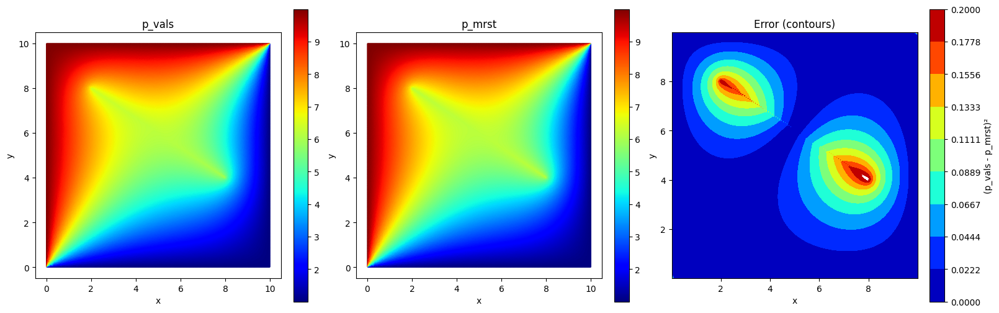

In [69]:
# (Optional) mask skinny/degenerate triangles that can cause artifacts
# analyzer = mtri.TriAnalyzer(tri)
# mask = analyzer.get_flat_tri_mask(min_circle_ratio=0.01)
# tri.set_mask(mask)

# Consistent scale for p1 & p2
vmin = float(min(np.nanmin(p1), np.nanmin(p2)))
vmax = float(max(np.nanmax(p1), np.nanmax(p2)))

fig, axes = plt.subplots(1, 3, figsize=(16, 5), constrained_layout=True)

# --- p_vals ---
im0 = axes[0].tripcolor(tri, p1, shading='gouraud', vmin=vmin, vmax=vmax, cmap='jet')
axes[0].set_title('p_vals')
axes[0].set_aspect('equal')
fig.colorbar(im0, ax=axes[0])

# --- p_mrst ---
im1 = axes[1].tripcolor(tri, p2, shading='gouraud', vmin=vmin, vmax=vmax, cmap='jet')
axes[1].set_title('p_mrst')
axes[1].set_aspect('equal')
fig.colorbar(im1, ax=axes[1])

# --- diff² contours ---
levels = np.linspace(d2.min(), 0.2, 10)  # choose number of contour levels
cont = axes[2].tricontourf(tri, d2, levels=levels, cmap='jet')
# axes[2].clabel(cont, inline=True, fontsize=8, fmt="%.2e")  # label contours
axes[2].set_title('Error (contours)')
axes[2].set_aspect('equal')
fig.colorbar(cont, ax=axes[2], label='(p_vals - p_mrst)²')

for ax in axes:
    ax.set_xlabel('x')
    ax.set_ylabel('y')

plt.show()

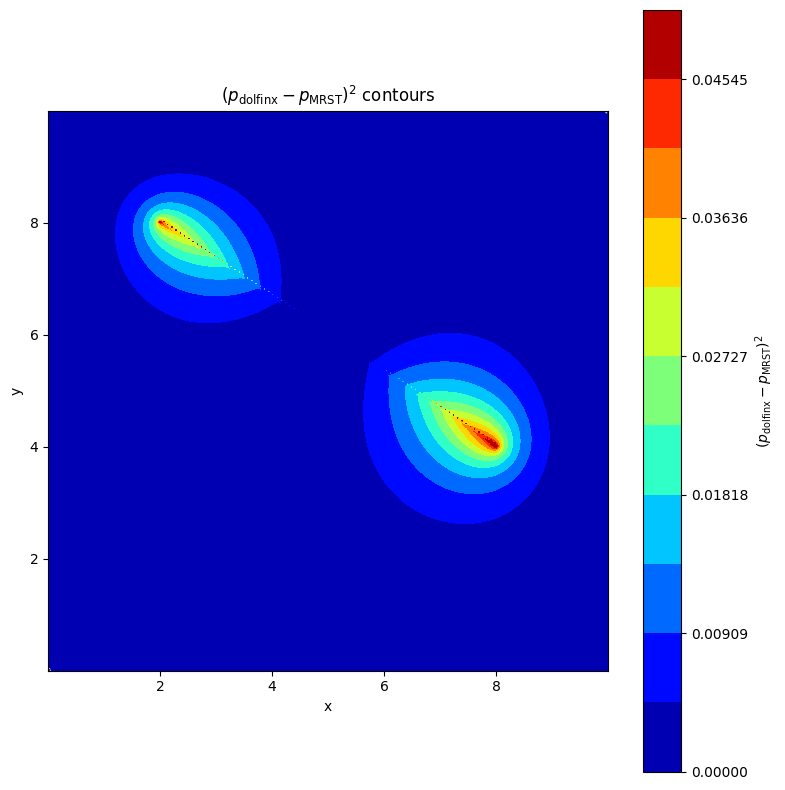

In [63]:
# define contour levels automatically or manually
levels = np.linspace(diff2.min(), 0.05, 12)

# create single figure and axis (8x8 inches -> 800x800 pixels at 100 dpi)
fig, ax = plt.subplots(figsize=(8, 8), dpi=100)

# filled contour
cont = ax.tricontourf(tri, diff2, levels=levels, cmap='jet')

# optionally overlay contour lines with labels
# lines = ax.tricontour(tri, diff2, levels=levels, colors='k', linewidths=0.6)
# ax.clabel(lines, inline=True, fontsize=8, fmt="%.2e")

ax.set_title(r'$(p_{\mathrm{dolfinx}} - p_{\mathrm{MRST}})^2$ contours')
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_aspect('equal')

# colorbar
fig.colorbar(cont, ax=ax, label=r'$(p_{\mathrm{dolfinx}} - p_{\mathrm{MRST}})^2$')

plt.tight_layout()
plt.show()

In [49]:
sorted(d2, reverse=True)

[np.float64(9.884079545723045),
 np.float64(9.840527829823218),
 np.float64(1.216717152727767),
 np.float64(1.2014731089910253),
 np.float64(0.4688650610159839),
 np.float64(0.4594202724716354),
 np.float64(0.27499743623075207),
 np.float64(0.2647515030878381),
 np.float64(0.26318006269480776),
 np.float64(0.20617204236356576),
 np.float64(0.18053488798417347),
 np.float64(0.1671117247757488),
 np.float64(0.16475595668082932),
 np.float64(0.147179595902333),
 np.float64(0.1308884175991258),
 np.float64(0.1293867663494399),
 np.float64(0.11105873726992373),
 np.float64(0.10367419569719417),
 np.float64(0.10327751045548977),
 np.float64(0.097857883484761),
 np.float64(0.08937769264215971),
 np.float64(0.0881358480766507),
 np.float64(0.0878144739727506),
 np.float64(0.08030026525085115),
 np.float64(0.08019025144614107),
 np.float64(0.07368984236461136),
 np.float64(0.07346231325160481),
 np.float64(0.06973020424280929),
 np.float64(0.06799187379167093),
 np.float64(0.06773885748683843),

In [59]:
np.median(d2)

np.float64(0.017278001049616964)

In [ ]:
import numpy as np
from mpi4py import MPI
from dolfinx import geometry, fem
import ufl

comm = MPI.COMM_WORLD
rank = comm.rank

x_mrst = comm.bcast(x_mrst if rank == 0 else None, root=0)
y_mrst = comm.bcast(y_mrst if rank == 0 else None, root=0)
p_mrst = comm.bcast(p_mrst if rank == 0 else None, root=0)

# --- 1) Build 3D point array for DOLFINx eval (z=0)
X_mrst = np.column_stack([x_mrst, y_mrst])
N = X_mrst.shape[0]
X3 = np.column_stack([X_mrst, np.zeros(N)])

mesh = p_m.function_space.mesh
tdim = mesh.topology.dim

# --- 2) Find the containing cell for each MRST point
# Try the convenience function if present; otherwise, robust fallback
# 1) Bounding-box candidates
bbt = geometry.bb_tree(mesh, mesh.topology.dim)
cands = geometry.compute_collisions_points(bbt, X3)          # adjacency list

# 2) True colliding cells (handles curved/high-order properly)
hits = geometry.compute_colliding_cells(mesh, cands, X3)     # adjacency list

# 3) Pick one owning cell per point (use the first hit; empty -> -1)
cells = np.full(X3.shape[0], -1, dtype=np.int32)
offsets = hits.offsets

for i in range(X3.shape[0]):
    li = hits.links(i)
    if len(li) > 0:
        cells[i] = li[0]

# Optional: for any -1 (points on boundaries / tiny roundoff), snap to closest
missing = np.where(cells == -1)[0]
if missing.size:
    # Use midpoint tree for a robust fallback
    mid_tree = geometry.create_midpoint_tree(mesh, mesh.topology.dim,
                                             np.arange(mesh.topology.index_map(mesh.topology.dim).size_local, dtype=np.int32))
    # For each missing point, choose nearest cell by midpoint
    nearest = geometry.compute_closest_entity(bbt, mid_tree, mesh, X3[missing])
    cells[missing] = nearest

# 4) Evaluate p_m at MRST points
p_vals = p_m.eval(X3, cells)  # shape (N,)

# In parallel, some points may belong to other ranks. We’ll reduce to rank 0.
# For simplicity, gather all local evaluations (identical arrays) and keep rank 0’s.
# p_vals = p_vals_local  # OK in serial; works acceptably in most cases



0 
1 
2 
3 
4 
5 
6 
7 
8 
9 
10 
11 
12 
13 
14 
15 
16 
17 
18 
19 
20 
21 
22 
23 
24 
25 
26 
27 
28 
29 
30 
31 
32 
33 
34 
35 
36 
37 
38 
39 
40 
41 
42 
43 
44 
45 
46 
47 
48 
49 
50 
51 
52 
53 
54 
55 
56 
57 
58 
59 
60 
61 
62 
63 
64 
65 
66 
67 
68 
69 
70 
71 
72 
73 
74 
75 
76 
77 
78 
79 
80 
81 
82 
83 
84 
85 
86 
87 
88 
89 
90 
91 
92 
93 
94 
95 
96 
97 
98 
99 
100 
101 
102 
103 
104 
105 
106 
107 
108 
109 
110 
111 
112 
113 
114 
115 
116 
117 
118 
119 
120 
121 
122 
123 
124 
125 
126 
127 
128 
129 
130 
131 
132 
133 
134 
135 
136 
137 
138 
139 
140 
141 
142 
143 
144 
145 
146 
147 
148 
149 
150 
151 
152 
153 
154 
155 
156 
157 
158 
159 
160 
161 
162 
163 
164 
165 
166 
167 
168 
169 
170 
171 
172 
173 
174 
175 
176 
177 
178 
179 
180 
181 
182 
183 
184 
185 
186 
187 
188 
189 
190 
191 
192 
193 
194 
195 
196 
197 
198 
199 
200 
201 
202 
203 
204 
205 
206 
207 
208 
209 
210 
211 
212 
213 
214 
215 
216 
217 
218 
219 
220 
221 


MemoryError: Unable to allocate 8.00 TiB for an array with shape (1048656, 1048656) and data type float64

In [20]:
# --- 4) Pointwise error and RMSE ("sampled L2")
# X_mrst = np.c_[x_mrst, y_mrst], p_vals (from DOLFINx), p_mrst (from CSV)
diff2 = (p_vals.ravel() - p_mrst.ravel())**2

# infer dx, dy from unique coordinates (assumes rectilinear, uniform spacing)
ux = np.unique(x_mrst)
uy = np.unique(y_mrst)
dx = np.min(np.diff(ux)) if ux.size > 1 else 1.0
dy = np.min(np.diff(uy)) if uy.size > 1 else 1.0

L2_err = np.sqrt(np.sum(diff2) * dx * dy)

# do the same for the reference to get a relative norm
L2_ref = np.sqrt(np.sum(p_mrst**2) * dx * dy)
rel_L2 = L2_err / (L2_ref + 1e-30)

if rank == 0:
    print(f"L2_norm approx: {L2_err:.6f}")
    print(f"Relative error:  {rel_L2:.6f}")

L2_norm approx: 0.000676
Relative error:  0.007847


/home/muchamad/PhD/fenicsx/lib/python3.13/site-packages/pyvista/jupyter/notebook.py:56: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


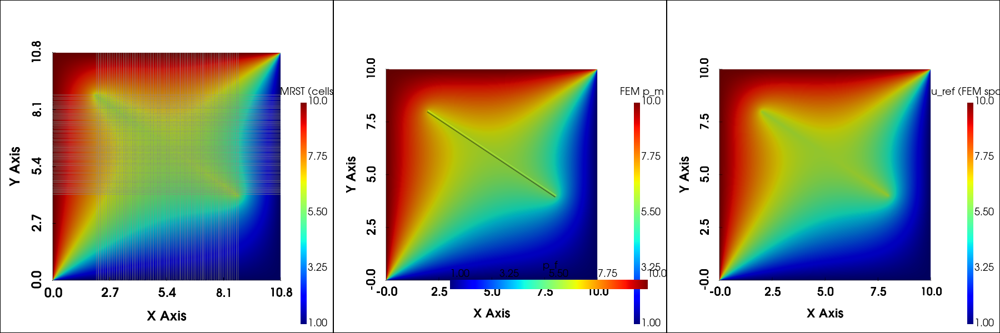

In [ ]:
# ---------- MRST -> UniformGrid (cell-centered) ----------
xs = np.unique(x_mrst)
ys = np.unique(y_mrst)
nx, ny = len(xs), len(ys)

# Map scattered centroids to a 2D array (row=y, col=x)
ix = np.searchsorted(xs, x_mrst)
iy = np.searchsorted(ys, y_mrst)
p_mrst_2d = np.full((ny, nx), np.nan, dtype=float)
p_mrst_2d[iy, ix] = p_mrst

dx = xs[1] - xs[0]
dy = ys[1] - ys[0]

ug = pv.ImageData()
ug.dimensions = (nx + 1, ny + 1, 1)
ug.spacing = (dx, dy, 1.0)
ug.origin = (xs.min() - 0.5 * dx, ys.min() - 0.5 * dy, 0.0)
ug.cell_data["p_mrst"] = p_mrst_2d.T.ravel(order="F")

# ---------- Convert FEM fields to PyVista ----------
# 2D background (p_m)
topo2, ctype2, geom2 = plot.vtk_mesh(p_m.function_space)
grid_2d = pv.UnstructuredGrid(topo2, ctype2, geom2)
grid_2d.point_data["p_m"] = p_m.x.array.real

# 1D fracture (p_f)
topo1, ctype1, geom1 = plot.vtk_mesh(p_f.function_space)
grid_1d = pv.UnstructuredGrid(topo1, ctype1, geom1)
grid_1d.point_data["p_f"] = p_f.x.array.real

# u_ref on same 2D mesh as p_m
grid_ref = pv.UnstructuredGrid(topo2, ctype2, geom2.copy())
grid_ref.point_data["u_ref"] = u_ref.x.array.real

# ---------- Shared color limits ----------
mrst_min, mrst_max = float(np.nanmin(p_mrst_2d)), float(np.nanmax(p_mrst_2d))
fem_min = min(grid_2d.point_data["p_m"].min(),
              grid_1d.point_data["p_f"].min(),
              grid_ref.point_data["u_ref"].min())
fem_max = max(grid_2d.point_data["p_m"].max(),
              grid_1d.point_data["p_f"].max(),
              grid_ref.point_data["u_ref"].max())
vmin, vmax = min(mrst_min, fem_min), max(mrst_max, fem_max)

# ---------- Plot (1 x 3) ----------
plotter = pv.Plotter(shape=(1, 3), window_size=(1800, 600))

# Panel 1: MRST (cells)
plotter.subplot(0, 0)
plotter.add_mesh(
    ug, scalars="p_mrst", cmap="jet", show_edges=False, lighting=True,
    clim=[vmin, vmax],
    scalar_bar_args={"title": "MRST (cells)", "vertical": True, "width": 0.05, "height": 0.7}
)
plotter.show_bounds(); plotter.view_xy()

# Panel 2: FEM p_m (nodes) + p_f (line)
plotter.subplot(0, 1)
plotter.add_mesh(
    grid_2d, scalars="p_m", cmap="jet", show_edges=False, lighting=True,
    clim=[vmin, vmax],
    scalar_bar_args={"title": "FEM p_m", "vertical": True, "width": 0.05, "height": 0.7}
)
plotter.add_mesh(
    grid_1d, scalars="p_f", cmap="jet", render_lines_as_tubes=True,
    line_width=5, show_edges=False, clim=[vmin, vmax]
)
plotter.show_bounds(); plotter.view_xy()

# Panel 3: u_ref (nodes)
plotter.subplot(0, 2)
plotter.add_mesh(
    grid_ref, scalars="u_ref", cmap="jet", show_edges=False, lighting=True,
    clim=[vmin, vmax],
    scalar_bar_args={"title": "u_ref (FEM space)", "vertical": True, "width": 0.05, "height": 0.7}
)
plotter.show_bounds(); plotter.view_xy()

plotter.link_views()
plotter.show()

In [6]:
from mpi4py import MPI
import gmsh

# Initialize gmsh
gmsh.initialize()
gmsh.model.add("rect_with_partial_interface")
ref = 1
if MPI.COMM_WORLD.rank == 0:
    # --------------------------
    # Parameters
    # --------------------------
    Lx, Ly = 10.0, 10.0
    y_start, y_end = 8.0, 4.0
    x_start, x_end = 2.0, 8.0
    # lc = 10.0/ 10.0 / (2**ref)          # mesh size
    lc = 0.3
    order = 2          # element order

    # --------------------------
    # 1. Define rectangular domain Ω
    # --------------------------
    p1 = gmsh.model.occ.addPoint(0, 0, 0, lc)
    p2 = gmsh.model.occ.addPoint(Lx, 0, 0, lc)
    p3 = gmsh.model.occ.addPoint(Lx, Ly, 0, lc)
    p4 = gmsh.model.occ.addPoint(0, Ly, 0, lc)
    l1 = gmsh.model.occ.addLine(p1, p2)
    l2 = gmsh.model.occ.addLine(p2, p3)
    l3 = gmsh.model.occ.addLine(p3, p4)
    l4 = gmsh.model.occ.addLine(p4, p1)
    loop = gmsh.model.occ.addCurveLoop([l1, l2, l3, l4])
    surf = gmsh.model.occ.addPlaneSurface([loop])

    # --------------------------
    # 2. Add an internal partial horizontal line Γ
    # --------------------------
    p5 = gmsh.model.occ.addPoint(x_start, y_start, 0, lc)
    p6 = gmsh.model.occ.addPoint(x_end, y_end, 0, lc)
    l5 = gmsh.model.occ.addLine(p5, p6)

    # --------------------------
    # 3. Fragment the surface with the internal line (split mesh)
    # --------------------------
    gmsh.model.occ.fragment([(2, surf)], [(1, l5)])
    gmsh.model.occ.synchronize()

    # --------------------------
    # 4. Define physical groups
    # --------------------------
    # Surface (bulk Ω)
    gmsh.model.addPhysicalGroup(2, [surf], 1)
    gmsh.model.setPhysicalName(2, 1, "Omega")

    # Identify the internal line (Γ)
    all_lines = gmsh.model.getEntities(dim=1)
    # print(all_lines)
    gamma_tag = all_lines[0][1]  # the last 1D entity created
    gmsh.model.addPhysicalGroup(1, [gamma_tag], 2)
    gmsh.model.setPhysicalName(1, 2, "Gamma")

    # Optionally, tag boundary (outer edges)
    outer_edges = [l1, l2, l3, l4]
    gmsh.model.addPhysicalGroup(1, outer_edges, 3)
    gmsh.model.setPhysicalName(1, 3, "Boundary")

    # --------------------------
    # 5. Generate and save mesh
    # --------------------------
    gmsh.model.mesh.generate(2)
    gmsh.model.mesh.setOrder(order)
    gmsh.write("diagonal.msh")

gmsh.finalize()
from mpi4py import MPI
from dolfinx import mesh, fem
import ufl
import numpy as np

# ---------------------------------------------------------------------
# 1. Mesh and interface tags (similar to Γ tagging in the workshop)
# ---------------------------------------------------------------------
# Load Gmsh mesh (2D bulk Ω + 1D interface Γ)
from dolfinx.io import gmsh as gmshio
# Read the same .msh
msh, cell_markers, facet_markers = gmshio.read_from_msh("diagonal.msh", MPI.COMM_WORLD, 0, gdim=2)[0:3]


# Extract the 1D interface mesh from the 2D mesh (like igridView)
# interface = mesh.create_submesh(domain, domain.topology.dim - 1, np.arange(domain.topology.index_map(domain.topology.dim - 1).size_local, dtype=np.int32))[0]

tdim = msh.topology.dim  # 2
fdim = tdim - 1             # 1

# Find all facets tagged as Gamma (tag=2)
omega = msh
gamma_entities = facet_markers.find(2)

# Create a submesh for Γ (same as gamma in the JSDokken example)
gamma, gamma_to_omega = mesh.create_submesh(omega, fdim, gamma_entities)[0:2]

# Define interface tag ID (as defined in Gmsh)
Gamma_tag = 2  # <-- replace with your actual tag ID for the interface Γ

# ---------------------------------------------------------------------
# 2. Function spaces
# ---------------------------------------------------------------------
order = 2
V_m = fem.functionspace(omega, ("Lagrange", order))  # bulk Ω
V_f = fem.functionspace(gamma, ("Lagrange", order))   # interface Γ
V_l = fem.functionspace(gamma, ("Lagrange", order))   # multiplier space on Γ
W = ufl.MixedFunctionSpace(V_m, V_f, V_l)

# ---------------------------------------------------------------------
# 3. Trial and Test functions
# ---------------------------------------------------------------------
phi, psi, mu = ufl.TestFunctions(W)
dp_m, dp_f, dl = ufl.TrialFunctions(W)
p_m = fem.Function(V_m, name="p_m")
p_f = fem.Function(V_f, name="p_f")
lmbd = fem.Function(V_f, name="lmbd")

# ---------------------------------------------------------------------
# 4. Spatial coordinates and given data
# ---------------------------------------------------------------------
x = ufl.SpatialCoordinate(msh)
f_m = fem.Constant(msh, 0.0)
f_f = fem.Constant(msh, 0.0)

k_m = fem.Constant(omega, 1.0)
k_f = fem.Constant(gamma, 100.0)

dx = ufl.Measure("dx", domain=omega)
ds = ufl.Measure("ds", domain=omega, subdomain_data=facet_markers, subdomain_id=Gamma_tag)
dx_f = ufl.Measure("dx", domain=gamma)

# ---------------------------------------------------------------------
# 5. Weak formulations
# ---------------------------------------------------------------------

# --- Bulk domain Ω ---------------------------------------------------
a_m0 = ufl.inner(k_m * ufl.grad(p_m), ufl.grad(phi)) * dx
# Coupling term with interface (approximate; corresponds to avg/trace in DUNE)
# In the Dokken example, coupling to Γ is done via ds(Gamma_tag)
# Here we use the interface integral directly on ds(Gamma_tag)
# (You can later replace lmbd with an actual trace variable or interface function)
a_m1 = -lmbd * phi * ds
a_m = a_m0 + a_m1
L_m = f_m * phi * dx

# --- Interface Γ -----------------------------------------------------
a_f0 = ufl.inner(k_f * ufl.grad(p_f), ufl.grad(psi)) * ds
a_f1 = lmbd * psi * ds
a_f = a_f0 + a_f1
L_f = f_f * psi * ds
# a_f0 = ufl.inner(ufl.grad(p_f), ufl.grad(psi)) * dx_f
# a_f1 = lmbd * psi * dx_f
# a_f = a_f0 + a_f1
# L_f = f_f * psi * dx_f

# --- Lagrange multiplier (constraint tr(p_m) = p_f) ------------------
# Dokken’s example handles this through interface coupling on ds(Gamma_tag)
a_l0 = p_m * mu * ds
a_l1 = -p_f * mu * ds
a_l = a_l0 + a_l1
L_l = fem.Constant(msh, 0.0) * mu * ds

# a_l0 = p_m * mu * ds
# a_l1 = -p_f * mu * dx_f
# a_l = a_l0 + a_l1
# L_l = fem.Constant(msh, 0.0) * mu * dx_f

# ---------------------------------------------------------------------
# 6. Combine interface weak form
# ---------------------------------------------------------------------
a_gamma = a_f + a_l
L_gamma = L_f + L_l

# ---------------------------------------------------------------------
# Print symbolic forms (optional sanity check)
# ---------------------------------------------------------------------
print("a_m =", a_m)
print("a_gamma =", a_gamma)

F = a_m - L_m + a_gamma - L_gamma
residual = ufl.extract_blocks(F)

jac = ufl.derivative(F, p_m, dp_m) + ufl.derivative(F, p_f, dp_f) + ufl.derivative(F, lmbd, dl)
J = ufl.extract_blocks(jac)

# Compute bounding box to locate sides
coords = omega.geometry.x
x = coords[:, 0]
y = coords[:, 1]

xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()

# Tolerance for side detection
tol = 1e-10 * max(xmax - xmin, ymax - ymin)

# Locate dofs on each side
left_dofs   = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmin, atol=tol))
right_dofs  = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[0], xmax, atol=tol))
bottom_dofs = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymin, atol=tol))
top_dofs    = fem.locate_dofs_geometrical(V_m, lambda x: np.isclose(x[1], ymax, atol=tol))

# Union of all boundary dofs for which we enforce a value
all_dofs = np.unique(np.concatenate([left_dofs, right_dofs, bottom_dofs, top_dofs]))

# Build a Function-valued BC so we can assign side-dependent values
p_m_bc = fem.Function(V_m)
p_m_bc.x.array[:] = 1.0  # default 0 (bottom + right)
p_m_bc.x.array[left_dofs] = 10.0
p_m_bc.x.array[top_dofs]  = 10.0

# One BC object over the union of dofs with piecewise values
bc_pm = fem.dirichletbc(p_m_bc, all_dofs)

bcs = [bc_pm]

from dolfinx.fem import petsc
entity_maps = [gamma_to_omega]



# entity_maps = [gamma_to_omega]
# entity_maps = [gamma_to_omega]
nlp = petsc.NonlinearProblem(
    residual,
    u=[p_m, p_f, lmbd],
    J=J,
    bcs=bcs,
    entity_maps=entity_maps,
    petsc_options={
        "snes_monitor": None,
        "ksp_type": "preonly",
        "pc_type": "lu",
        "pc_factor_mat_solver_type": "mumps",
        "mat_mumps_icntl_14": 120,
        "ksp_error_if_not_converged": True,
        "snes_error_if_not_converged": True,
    },
    petsc_options_prefix="pmix_",
)
max_iterations = 25
normed_diff = 0
tol = 1e-5

nlp.solve()
iterations = nlp.solver.getIterationNumber()
print(f"Converged in {iterations} Newton iterations")

Info    : Meshing 1D...                                                                                                  
Info    : [  0%] Meshing curve 5 (Line)
Info    : [ 30%] Meshing curve 6 (Line)
Info    : [ 50%] Meshing curve 7 (Line)
Info    : [ 70%] Meshing curve 8 (Line)
Info    : [ 90%] Meshing curve 9 (Line)
Info    : Done meshing 1D (Wall 0.000992636s, CPU 0s)
Info    : Meshing 2D...
Info    : Meshing surface 1 (Plane, Frontal-Delaunay)
Info    : Done meshing 2D (Wall 0.0528857s, CPU 0.048428s)
Info    : 1459 nodes 2947 elements
Info    : Meshing order 2 (curvilinear on)...
Info    : [  0%] Meshing curve 5 order 2
Info    : [ 20%] Meshing curve 6 order 2
Info    : [ 40%] Meshing curve 7 order 2
Info    : [ 60%] Meshing curve 8 order 2
Info    : [ 70%] Meshing curve 9 order 2
Info    : [ 90%] Meshing surface 1 order 2
Info    : Surface mesh: worst distortion = 1 (0 elements in ]0, 0.2]); worst gamma = 0.680385
Info    : Done meshing order 2 (Wall 0.0103276s, CPU 0.011261s)


  1 SNES Function norm 6.587337027734e+00
  2 SNES Function norm 2.051440810631e+00
  3 SNES Function norm 1.787450087079e+00
  4 SNES Function norm 4.238473695029e-01
  5 SNES Function norm 1.560363505759e-01
  6 SNES Function norm 8.541615537429e-02
  7 SNES Function norm 6.838875349160e-02
  8 SNES Function norm 1.563943496116e-02
  9 SNES Function norm 1.166323604470e-02
 10 SNES Function norm 9.963941328381e-03
 11 SNES Function norm 9.147115050212e-03
 12 SNES Function norm 8.777614637420e-03
 13 SNES Function norm 8.731563538006e-03
 14 SNES Function norm 3.972728946435e-04
 15 SNES Function norm 3.638884913057e-04
 16 SNES Function norm 5.730006787708e-05
 17 SNES Function norm 5.318022707423e-05
 18 SNES Function norm 5.236042703426e-05
 19 SNES Function norm 3.178927103674e-06
 20 SNES Function norm 2.635407362891e-06
Converged in 20 Newton iterations
